# Classification d'une musique au format `.wav`

In [1]:
import numpy as np
import pandas as pd
import random
import librosa
import matplotlib.pyplot as plt
import pickle

from sklearn.preprocessing import StandardScaler

## 1. Chargement du fichier audio

On renseigne tout d'abord le chemin du fichier audio que l'on souhaite analyser.

<font color='red'> <b> Attention, renseignez ici le chemin de la musique de votre choix en format .wav </font>

In [2]:
audio_path = "audios/01 Put It On.wav"

On échantillone le fichier audio en un NumPy array de dimension 1 `y`. L'[échantillonage](https://fr.wikipedia.org/wiki/%C3%89chantillonnage_(signal)#Cadence_d'%C3%A9chantillonnage) consiste à prélever les valeurs d'un signal à intervalles définis et produit une suite de valeurs discrètes nommées échantillons. La variable `sr` contient le taux d'échantillonage (ou cadence d'échantillonage) de `y`, c'est-à-dire le nombre d'échantillons par seconde de l'audio.

In [3]:
y, sr = librosa.load(audio_path)

In [4]:
import IPython.display as ipd
ipd.Audio(audio_path)

Text(0.5, 1.0, 'Stereo')

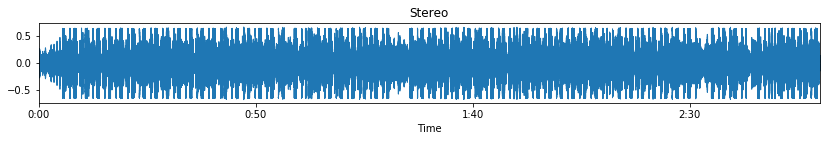

In [5]:
from librosa.display import waveplot
plt.figure(figsize=(14,5))
plt.subplot(3,1,2)
waveplot(y, sr=sr)
plt.title('Stereo')

Puis on détecte les onset, c'est-a-dire le début d'une note ou d'un autre son ([Onset Detection](https://librosa.github.io/librosa/generated/librosa.onset.onset_detect.html#librosa.onset.onset_detect)).

In [6]:
onset_frames = librosa.onset.onset_detect(y=y, sr=sr) # Frame numbers of estimates onsets
onset_times = librosa.frames_to_time(onset_frames)
print(onset_times[0])

0.11609977324263039


On recharge le fichier audio à partir de la première note.

In [7]:
y, sr = librosa.load(audio_path, offset=onset_times[0], duration=30)

## 2. Extraction des caractéristiques

Nous allons extraire les caractéristiques suivantes :
   * chroma_stft
   * rms
   * spectral_centroid
   * spectral_bandwidth
   * rolloff
   * zero_crossing_rate
   * mfcc (de 1 à 20)
   * spectral_contrast
   * spectral_flatness
   * tonnetz
   * estimated_tempo

In [8]:
features_values = []

# Extraction des caracteristiques
chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
rms = librosa.feature.rms(y=y)
spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
zcr = librosa.feature.zero_crossing_rate(y)
mfcc = librosa.feature.mfcc(y=y, sr=sr)

features_values.extend([np.mean(chroma_stft), np.mean(rms), np.mean(spec_cent), np.mean(spec_bw), np.mean(rolloff), np.mean(zcr)])

for value in  mfcc:
    features_values.append(np.mean(value))

spectral_contrast = librosa.feature.spectral_contrast(y=y)
spectral_flatness = librosa.feature.spectral_flatness(y=y)
tonnetz = librosa.feature.tonnetz(y=y)
tempo = librosa.beat.tempo(y=y)

features_values.extend([np.mean(spectral_contrast), np.mean(spectral_flatness), np.mean(tonnetz), tempo[0]])

In [9]:
print(features_values)

[0.38115132, 0.116855964, 2025.2299285795946, 2480.67577406955, 4676.630054391206, 0.06586657072368421, -174.0967, 85.96785, 17.98486, 43.82939, 14.424108, 19.756533, -0.8862352, 17.065025, -0.9077563, 11.034411, 3.4249227, 4.770937, 0.34991115, -0.3739764, -12.529817, -4.4390464, -11.366973, -4.2959166, -4.4883623, -0.56562746, 20.63310946422807, 0.012613231, -0.0002054429878559384, 89.10290948275862]


## 3. Récupération du meilleur modèle

Nous avons vu dans le notebook `Models_Comparaison.ipynb` que le meilleur modèle était ... Donc nous le récupérons :

In [10]:
path = "models/best_ovosvm.pickle"
with open(path, 'rb') as data:
    best_model = pickle.load(data)

In [11]:
print(best_model.get_params())

{'reg_strength': 72, 'max_iter': 80, 'batch_size': 67, 'learning_rate': 0.0001}


In [12]:
features_values = np.array(features_values).reshape(30,1)
features_values = np.transpose(features_values)
print(features_values.shape)

(1, 30)


In [14]:
print(best_model.predict(features_values))

[3]


Les différents genres sont :

Genre|Label
 -:| -:
blues|0
classical|1
country|2
disco|3
hiphop|4
jazz|5
metal|6
pop|7
reggae|8
rock|9

In [16]:
knn_path = "models/best_knn.pickle"
with open(knn_path, 'rb') as data:
    best_knn = pickle.load(data)
print(best_knn.predict(features_values))

[8]
